# Read and Visualize Annotations

This notebook provides simple methods for loading and visualizing both the real and synthetic datasets.

In [ ]:
import json
import os
import numpy as np
from PIL import Image
import pandas as pd
from pycocotools import mask as mask_utils
import torchvision.transforms as T
from wildlife_datasets.datasets import WildlifeDataset
from collections import defaultdict
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point
from matplotlib.lines import Line2D
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

/shared/results/common/kargin/tck_miniconda3/envs/ex-reid/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
def load_image(row, root_path):
    """
    Load an image, its mask, and pose keypoints from a dataset row.

    Args:
        row (pd.Series): A row from the dataset containing 'path', 'mask', and optionally 'pose'.
        root_path (str): The root directory where images are stored.

    Returns:
        image (PIL.Image.Image): Loaded image.
        mask (np.ndarray): Decoded mask with shape (H, W, 1) as uint8.
        pose (dict or None): Pose keypoints if available, else None.
    """
    # Load pose if it exists and is a string
    pose = json.loads(row['pose']) if isinstance(row.get('pose'), str) else None

    # Load image
    image_path = os.path.join(root_path, row['path'])
    image = Image.open(image_path).convert("RGB")  # Ensure image is in RGB

    # Decode mask
    mask_data = json.loads(row['mask'])
    mask = mask_utils.decode(mask_data).astype(np.uint8)
    mask = np.expand_dims(np.asfortranarray(mask), axis=-1)  # Ensure shape (H, W, 1)

    return image, mask, pose

In [3]:
root_path = "/shared/sets/datasets/vision/czechlynx/CzechLynx_v2"
metadata_real = pd.read_csv(os.path.join(root_path, "CzechLynxDataset-Metadata-Real.csv"))
metadata_synthetic = pd.read_csv(os.path.join(root_path, "CzechLynxDataset-Metadata-Synthetic.csv"))

examples = 16
seed = 0

## Visualize random real images

(1439, 1439, 1)
(652, 651, 1)
(399, 399, 1)
(1901, 1902, 1)
(471, 472, 1)
(324, 325, 1)
(299, 298, 1)
(625, 625, 1)
(666, 666, 1)
(359, 359, 1)
(1045, 1045, 1)
(275, 275, 1)
(900, 900, 1)
(936, 936, 1)
(299, 298, 1)
(915, 916, 1)


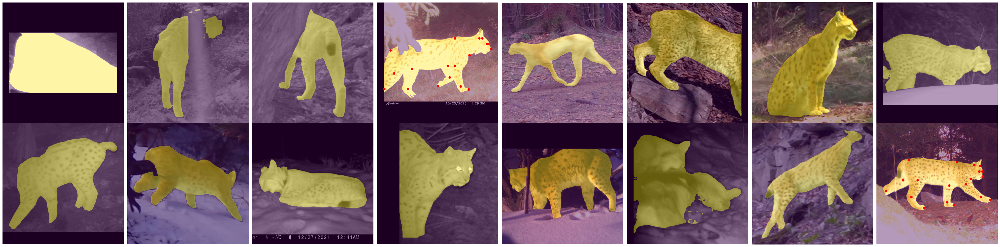

In [ ]:
# Select random row indices
np.random.seed(seed)
idxs = np.random.permutation(len(metadata_real))[:examples]

# Create subplots
fig, ax = plt.subplots(2, examples // 2, figsize=((examples // 2) * 5, 2 * 5))
ax = ax.flatten()

# Plot images with masks and keypoints (if available)
for i, idx in enumerate(idxs):
    row = metadata_real.iloc[idx]
    image, mask, pose = load_image(row, root_path)
    
    ax[i].imshow(image)
    ax[i].imshow(mask, alpha=0.4)
    
    if pose:
        x, y = zip(*pose.values())
        ax[i].scatter(x, y, color='red')
    
    ax[i].axis('off')

plt.tight_layout()
plt.show()

## Visualize real images with keypoints

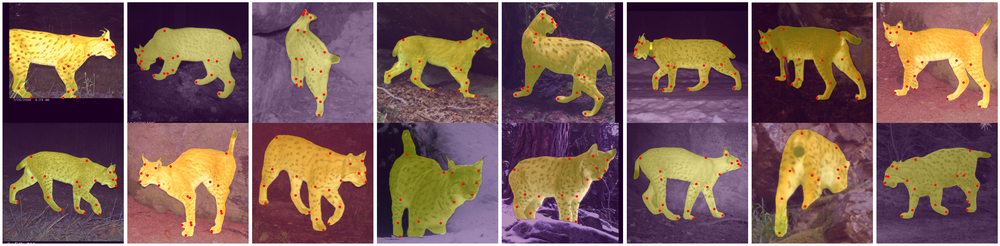

In [5]:
# Select random row indices
np.random.seed(seed)
_metadata_real = metadata_real[~metadata_real['pose'].isna()]
idxs = np.random.permutation(len(_metadata_real))[:examples]

# Create subplots
fig, ax = plt.subplots(2, examples // 2, figsize=((examples // 2) * 5, 2 * 5))
ax = ax.flatten()

# Plot images with masks and keypoints (if available)
for i, idx in enumerate(idxs):
    row = _metadata_real.iloc[idx]
    image, mask, pose = load_image(row, root_path)
    
    ax[i].imshow(image)
    ax[i].imshow(mask, alpha=0.4)
    
    if pose:
        x, y = zip(*pose.values())
        ax[i].scatter(x, y, color='red')
    
    ax[i].axis('off')

plt.tight_layout()
plt.show()

## Visualize random synthetic images

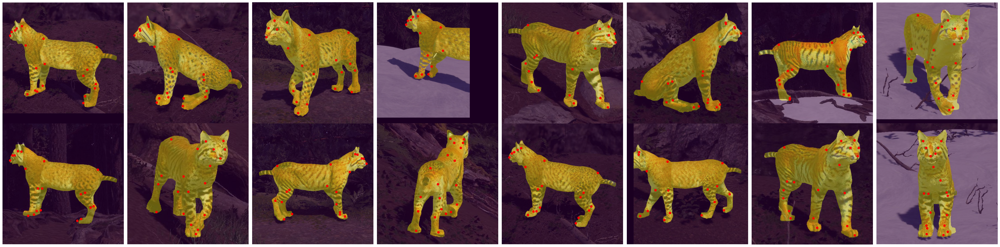

In [6]:
# Select random row indices
np.random.seed(seed)
idxs = np.random.permutation(len(metadata_synthetic))[:examples]

# Create subplots
fig, ax = plt.subplots(2, examples // 2, figsize=((examples // 2) * 5, 2 * 5))
ax = ax.flatten()

# Plot images with masks and keypoints (if available)
for i, idx in enumerate(idxs):
    row = metadata_synthetic.iloc[idx]
    image, mask, pose = load_image(row, root_path)
    
    ax[i].imshow(image)
    ax[i].imshow(mask, alpha=0.4)
    
    if pose:
        x, y = zip(*pose.values())
        ax[i].scatter(x, y, color='red')
    
    ax[i].axis('off')

plt.tight_layout()
plt.show()

📊 Visualizing Data

We use datasets.WildlifeDataset from wildlife-datasets to load and work with the dataset. The following code specify which transform we want to use while loading images and that we want to load labels alongside images.

In [7]:
transform_display = T.Compose([
    T.Resize([224, 224]),
])

transform = T.Compose([
    *transform_display.transforms,
    T.ToTensor(),
    T.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225))
])

dataset = WildlifeDataset(root_path, metadata_real, transform=transform_display, load_label=True, col_label="unique_name")

display(dataset.metadata.head())

,source,date,encounter,unique_name,path,relative_age,coat_pattern,location,cell_code,latitude,longitude,trap_id,split-geo_aware,split-time_open,split-time_closed,split-pose,mask,pose
0,foe_carpaths,27-03-2012,5165,lynx_296,CzechLynx/foe_carpaths/lynx_296/00000_lynx_296...,0.0,NaN,horni_becva-1,10kmE492N295,49.39917,18.34007,foe_carpaths-21,test,train,train,test,"{""size"": [1224, 1224], ""counts"": ""_kd62VV14L4L...","{""R-F-wrist"": [448, 809], ""L-F-wrist"": [331, 9..."
1,foe_carpaths,04-04-2012,5166,lynx_296,CzechLynx/foe_carpaths/lynx_296/00001_lynx_296...,0.0,NaN,horni_becva-1,10kmE492N295,49.39917,18.34007,foe_carpaths-21,test,train,train,test,"{""size"": [1400, 1400], ""counts"": ""Vdo33a[18H8f...","{""throat"": [379, 743], ""nose"": [124, 767], ""ri..."
2,foe_carpaths,14-05-2012,5167,lynx_296,CzechLynx/foe_carpaths/lynx_296/00002_lynx_296...,0.0,NaN,horni_becva-1,10kmE492N295,49.39917,18.34007,foe_carpaths-21,test,train,train,test,"{""size"": [723, 723], ""counts"": ""PPm05]f09G8I4K...","{""throat"": [554, 240], ""left-eye"": [560, 152],..."
3,foe_carpaths,03-03-2012,5168,lynx_023,CzechLynx/foe_carpaths/lynx_023/00003_lynx_023...,3.0,NaN,horni_becva-1,10kmE492N295,49.39917,18.34007,foe_carpaths-21,test,train,train,test,"{""size"": [1599, 1598], ""counts"": ""Tio=1oa11N1O...","{""L-B-paw"": [1112, 1209], ""L-F-paw"": [973, 150..."
4,foe_carpaths,14-04-2012,5169,lynx_023,CzechLynx/foe_carpaths/lynx_023/00004_lynx_023...,3.0,NaN,horni_becva-1,10kmE492N295,49.39917,18.34007,foe_carpaths-2,test,train,test,test,"{""size"": [599, 599], ""counts"": ""kjU1a0Ua0\\1l_...","{""right-earbase"": [417, 121], ""L-F-elbow"": [37..."


Plotting a sample grid of the data. The images in the dataset have their backgrounds removed.

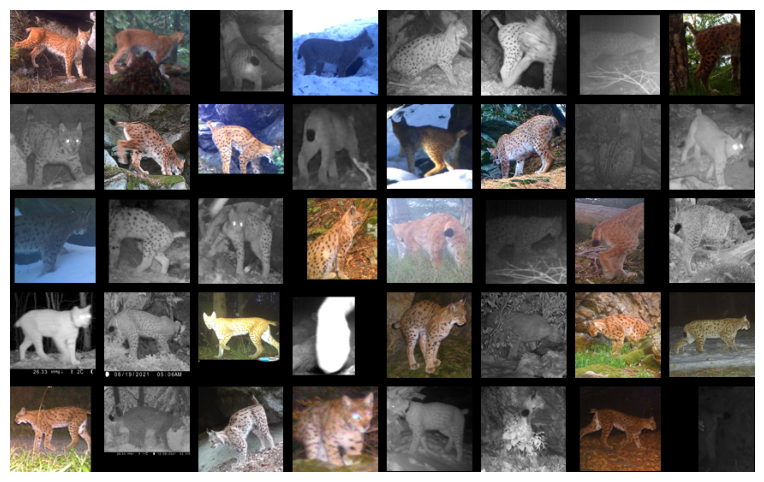

In [8]:
fig = dataset.plot_grid()
fig.set_size_inches(12, 6)

Examples of images showing a single individual.

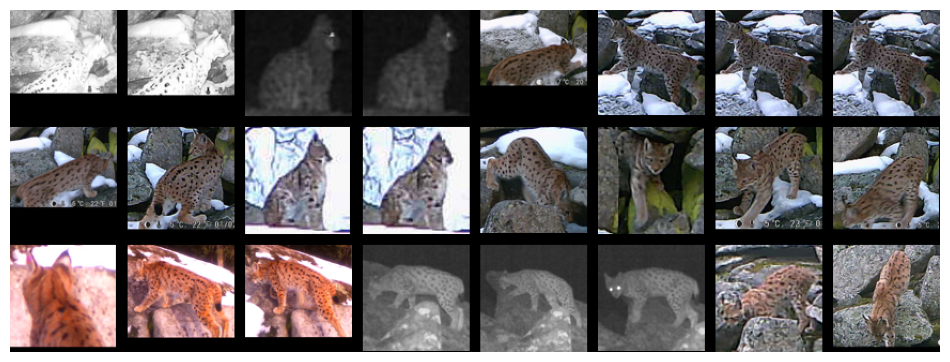

In [9]:
idx = dataset.metadata['unique_name'] == "lynx_202"
idx[idx.isnull()] = False
fig = dataset.plot_grid(idx=idx)
fig.set_size_inches(12, 6)

In [10]:
def visualize_cell_frequencies(data, ax = None, legend = True, point_size = (3, 70)):
    cell_counts = dict(data.cell_code.value_counts())
    cell_lat = dict(zip(data.cell_code, data.latitude))
    cell_lon = dict(zip(data.cell_code, data.longitude))
    cell_src = defaultdict(set)
    for cell, src in zip(data.cell_code, data.source):
        cell_src[cell].add(src)
    cell_src = {cell: tuple(sorted(set(sources))) for cell, sources in cell_src.items()}
    data = [[cell_lat[cell], cell_lon[cell], cell_counts[cell], cell] for cell, cont in cell_counts.items()]
    
    # Create GeoDataFrame
    points_gdf = gpd.GeoDataFrame(
        data,
        columns=["lat", "lon", "value", "cell"],
        geometry=[Point(lon, lat) for lat, lon, _, _ in data],
        crs="EPSG:4326"
    )
    
    # Plot map
    world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
    if ax is None:
        fig, ax = plt.subplots(figsize=(10, 8))
    world.plot(ax=ax, color='lightgray', edgecolor='white')
    
    # Plot cell cneters
    points_gdf.plot(
        ax=ax,
        markersize=np.interp(points_gdf["value"],[points_gdf["value"].min(), points_gdf["value"].max()], point_size),
        color=[colors[cell_src[c]] for c in points_gdf['cell']],
        alpha=0.6,
    )

    # Adjust boundaries
    miny, maxy, minx, maxx = 48.55, 51.06, 12.09, 18.86
    padding_x = (maxx - minx) * 0.15
    padding_y = (maxy - miny) * 0.15
    
    ax.set_xlim(minx - padding_x, maxx + padding_x)
    ax.set_ylim(miny - padding_y, maxy + padding_y)
    if legend:
        legend_handles = [Line2D([0], [0], marker='o', markerfacecolor=c, markersize=10, color='w', alpha=0.6, label=", ".join(name)) for name, c in colors.items()]
        ax.legend(handles=legend_handles)


colors = {
    ("snpa",): "red",
    ('foe_bohemia',): "blue",
    ('foe_bohemia', 'snpa'): "purple",
    ('foe_carpaths',): "green"
}

Visualization of locations. Each point on the map represents an area of 10×10 km. The size of the point indicates how many images were captured in that area, and the color of the point indicates the source of the data.

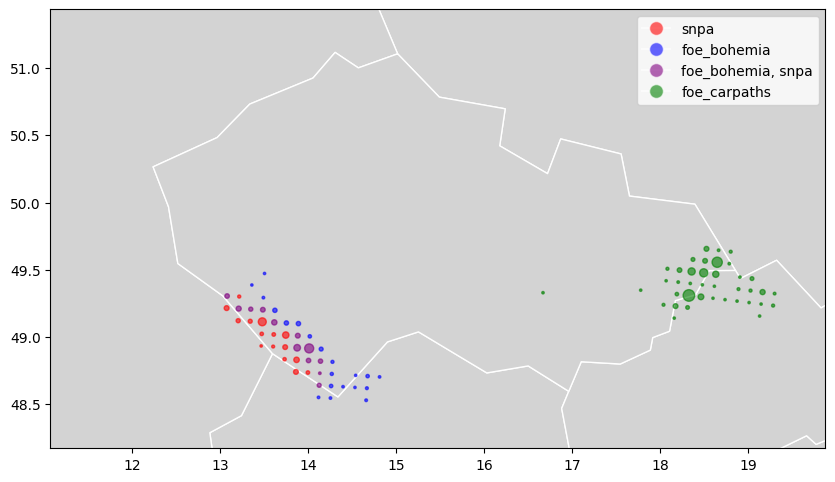

In [11]:
visualize_cell_frequencies(dataset.metadata)

Individual animals visit frequency. We can also visualize how often individuals occur in the cells.

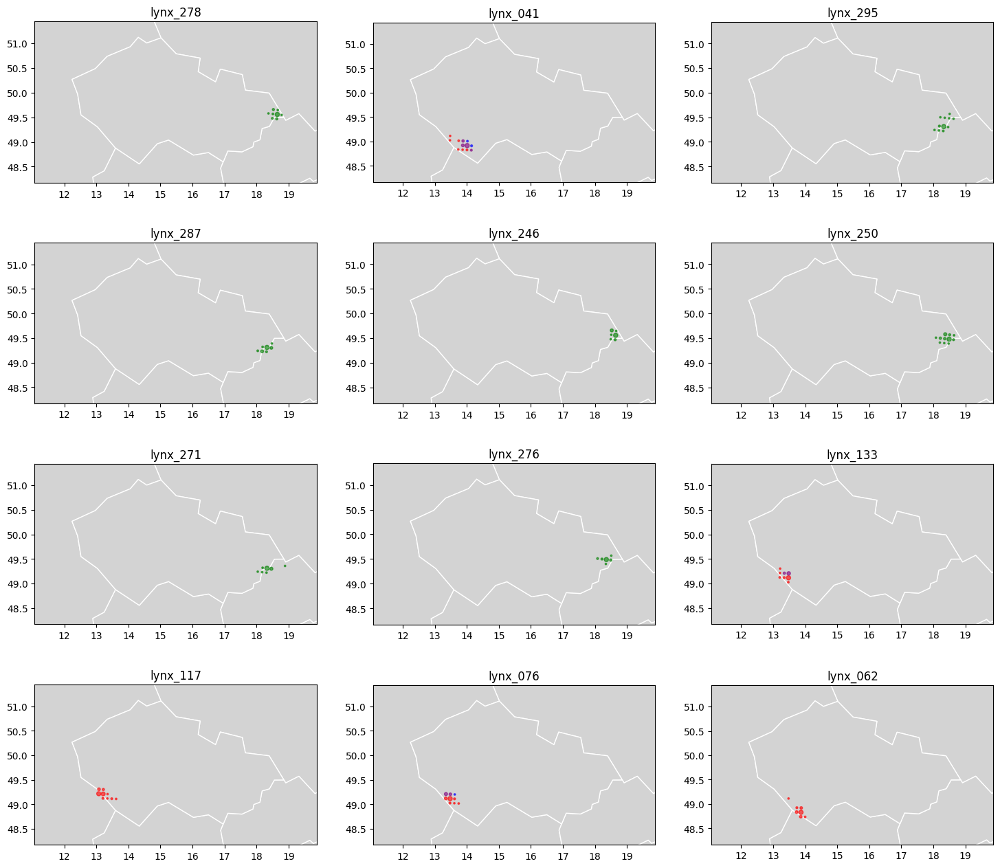

In [12]:
unique_names = list(dataset.metadata.unique_name.value_counts().keys())
rows, cols = 4, 3

fig, ax = plt.subplots(rows, cols, figsize=(cols*6, rows*4))
ax = ax.flatten()

for i in range(len(ax)):
    individual_data = dataset.metadata[dataset.metadata.unique_name == unique_names[i]]
    visualize_cell_frequencies(individual_data, ax[i], False, (3, 20))
    ax[i].set_title(unique_names[i])
plt.show()
